# SURFACE PLAY 1

## Goals

1. Go through some nilearn demos on surface plotting + analysis.
2. Try to understand the file types.
3. Do something minimal on data output from MRIPREP.
4. Determine roadmap.

## NILEARN DEMO

I am roughly following this demo here:

https://nilearn.github.io/auto_examples/01_plotting/plot_surf_stat_map.html#sphx-glr-auto-examples-01-plotting-plot-surf-stat-map-py

In [70]:
import nilearn
from nilearn import surface

This downloads some of the example data.

In [2]:
from nilearn import datasets

nki_dataset = datasets.fetch_surf_nki_enhanced(n_subjects=1)

In [3]:
nki_dataset

{'func_left': ['/Users/nicholashedger/nilearn_data/nki_enhanced_surface/A00028185/A00028185_left_preprocessed_fwhm6.gii'],
 'func_right': ['/Users/nicholashedger/nilearn_data/nki_enhanced_surface/A00028185/A00028185_right_preprocessed_fwhm6.gii'],
 'phenotypic': array([('A00028185', 26., 'R', 'M')],
       dtype=[('Subject', '<U9'), ('Age', '<f8'), ('Dominant_Hand', '<U1'), ('Sex', '<U1')]),
 'description': b"NKI enhanced surface\r\n\r\n\r\nNotes\r\n-----\r\nEnhanced Nathan Kline Institute-Rockland Sample resting state fMRI data\r\n(TR=645ms) of 102 subjects, preprocessed and projected to the fsaverage5 surface\r\naccording to https://github.com/fliem/nki_nilearn.\r\nContains phenotypical metadata.\r\n\r\nContent\r\n-------\r\n    :'func_left': resting-state data for the left hemisphere\r\n    :'func_right': resting-state data for the right hemisphere\r\n    :'phenotypic': phenotypical metadata\r\n\r\n\r\nReferences\r\n----------\r\n:Download: http://fcon_1000.projects.nitrc.org/indi/e

We have a pair of gifti files (1 for each hemisphere).

Import the left hemisphere with the 'load_surf_data' command

In [22]:
timeseries = surface.load_surf_data(nki_dataset['func_left'][0])

In [23]:
timeseries.shape

(10242, 895)

Since this is labelled as 'timeseries', I am going to assume that the larger dimension represents vertices and the smaller dimension represents time (I can't see 10242 TRs making much sense).

The blurb output above indicates that this data are in fsaverage5 space, which according to documentation I can find, should have 10,000 vertices. Therefore, the first dimension must be the vertex number.

I assumed that there would also be some spatial information encoded in here too - another dimension that maps the data itself to a point on the surface. Perhaps this mapping is performed elsewhere.

In [24]:
import matplotlib.pyplot as plt

This is the timeseries data for the first vertex

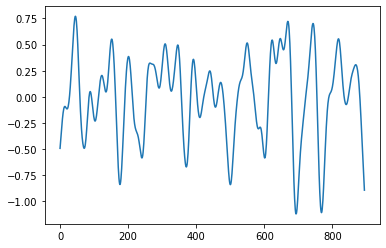

In [25]:
plt.plot(timeseries[0,:])

In [26]:
# Destrieux parcellation for left hemisphere in fsaverage5 space
destrieux_atlas = datasets.fetch_atlas_surf_destrieux()
parcellation = destrieux_atlas['map_left']
labels = destrieux_atlas['labels']

In [27]:
parcellation

array([29, 27,  8, ..., 23, 62, 62], dtype=int32)

In [10]:
parcellation.shape

(10242,)

In [28]:
import numpy

In [29]:
numpy.unique(parcellation)

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51,
       52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68,
       69, 70, 71, 72, 73, 74, 75], dtype=int32)

In [30]:
len(labels)

76

The above indicates that the 'parcellation' data gives one of 75 integers for each vertex. Each one of these integers is associated with a corresponding label. Below for instance, we select data from one of these parcellations and take the mean time-series.   

In [31]:
pcc_region = b'G_cingul-Post-dorsal'

import numpy as np
pcc_labels = np.where(parcellation == labels.index(pcc_region))[0]

# Extract time series from seed region
seed_timeseries = np.mean(timeseries[pcc_labels], axis=0)

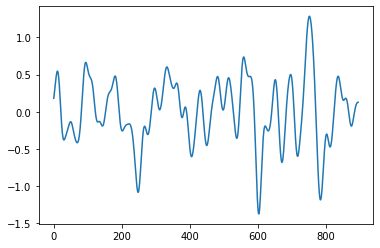

In [32]:
plt.plot(seed_timeseries)

Now, we compute the correlation between this seed timeseries and voxels elsewhere in the brain. 

In [33]:
from scipy import stats

stat_map = np.zeros(timeseries.shape[0])
for i in range(timeseries.shape[0]):
    stat_map[i] = stats.pearsonr(seed_timeseries, timeseries[i])[0]

# Re-mask previously masked nodes (medial wall)
stat_map[np.where(np.mean(timeseries, axis=1) == 0)] = 0

/Users/nicholashedger/anaconda2/envs/py3env/lib/python3.6/site-packages/scipy/stats/stats.py:3508: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


This gives us a dataset the same size as our original dataset 

In [34]:
stat_map.shape

(10242,)

Now it seems as though we import fsaverage for plotting.

In [35]:
from nilearn import plotting

fsaverage = datasets.fetch_surf_fsaverage()

In [36]:
fsaverage

{'pial_left': '/Users/nicholashedger/anaconda2/envs/py3env/lib/python3.6/site-packages/nilearn/datasets/data/fsaverage5/pial.left.gii.gz',
 'pial_right': '/Users/nicholashedger/anaconda2/envs/py3env/lib/python3.6/site-packages/nilearn/datasets/data/fsaverage5/pial.right.gii.gz',
 'infl_left': '/Users/nicholashedger/anaconda2/envs/py3env/lib/python3.6/site-packages/nilearn/datasets/data/fsaverage5/pial_inflated.left.gii.gz',
 'infl_right': '/Users/nicholashedger/anaconda2/envs/py3env/lib/python3.6/site-packages/nilearn/datasets/data/fsaverage5/pial_inflated.right.gii.gz',
 'sulc_left': '/Users/nicholashedger/anaconda2/envs/py3env/lib/python3.6/site-packages/nilearn/datasets/data/fsaverage5/sulc.left.gii.gz',
 'sulc_right': '/Users/nicholashedger/anaconda2/envs/py3env/lib/python3.6/site-packages/nilearn/datasets/data/fsaverage5/sulc.right.gii.gz',
 'description': b"fsaverage5\r\n\r\n\r\nNotes\r\n-----\r\nFsaverage5 standard surface as distributed with Freesurfer (Fischl et al, 1999)\r\n\

This is a list of a bunch of different surfaces. Before plotting, I want to see what is contained in these files.

In [37]:
fsa = surface.load_surf_data(fsaverage['pial_left'])

In [38]:
fsa.shape

(2,)

It's a list of length 2 (??)

In [39]:
fsa[0,].shape

(10242, 3)

This is more like it! Here we have data with the same number of vertices, but with 3 dimensions. This must be where spatial information is encoded.

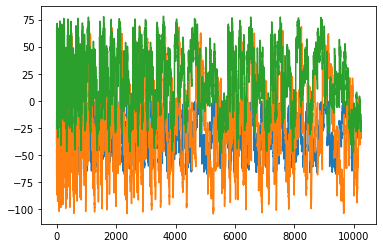

In [40]:
plt.plot(fsa[0,])

These must be some properties of the surface.

My hunch is that we can make more sense of this by plotting things in 3D instead.

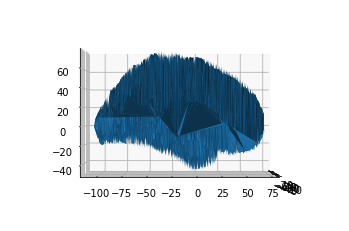

In [41]:
fsab=np.squeeze(fsa[0])
fig = plt.figure()
ax = fig.add_subplot(1,1,1, projection='3d')
ax.view_init(0, 0)
ax.plot_trisurf(fsab[:,0],fsab[:,1],fsab[:,2])

Maybe this the surface of a hemisphere? My logic is that if we read in an 'inflated' surface instead, we should be able to observe something that looks a little more 'hemispheric'

In [42]:
fsinf = surface.load_surf_data(fsaverage['infl_left'])

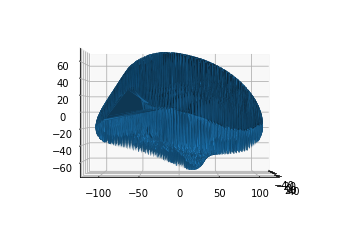

In [43]:
fsinfb=np.squeeze(fsinf[0])
fig = plt.figure()
ax = fig.add_subplot(1,1,1, projection='3d')
ax.view_init(0, 0)
ax.plot_trisurf(fsinfb[:,0],fsinfb[:,1],fsinfb[:,2])

Indeed. Now, we use the geometry contained within the fsaverage surfaces to plot out correlation stat map.

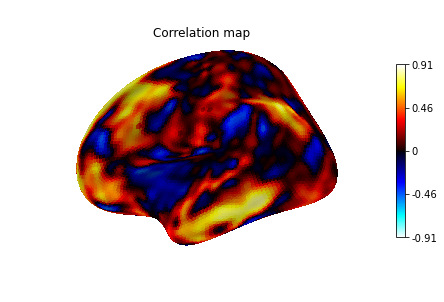

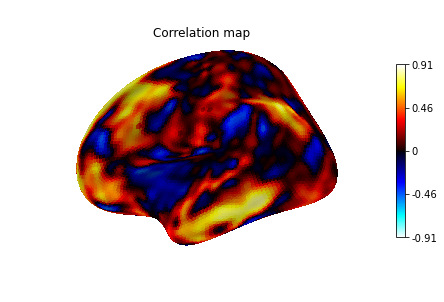

In [44]:
pcc_map = np.zeros(parcellation.shape[0], dtype=int)
pcc_map[pcc_labels] = 1

from nilearn import plotting

plotting.plot_surf_stat_map(fsaverage['infl_left'], stat_map=stat_map,
                            hemi='left', view='lateral', colorbar=True,
                            bg_map=fsaverage['sulc_left'], bg_on_data=True,
                            darkness=.6, title='Correlation map')

I'm not exactly sure why everything seems to be plotting twice.

## APPLICATION TO OWN DATA

Set the path to the relevant outputs of fmriprep

In [45]:
funcpath='/Volumes/BAHAMUT/PRF_DATA/ds002574-download/derivatives/fmriprep/sub-02/ses-01/func'
surfpath='/Volumes/BAHAMUT/PRF_DATA/ds002574-download/derivatives/freesurfer/fsaverage/surf'

In [46]:
def findgiftis(FOLDER,ext):
    
    # Function goal: return nifti files within a directory
    
    # Detail: could be used for a file with any extension...
    
    #Inputs
    
    # FOLDER (directory to search)
    # ext (the suffix (.nii or .nii.gz))
    
    def fprintf(stream, format_spec, *args):
        stream.write(format_spec % args)
    import os
    import sys
    niftilist=list()
    for file in os.listdir(FOLDER):
        if file.endswith(ext):
            niftilist.append(FOLDER+"/"+file)
    fprintf(sys.stdout, "Found %d gifti files \n", len(niftilist))
    return(sorted(niftilist))

Get the functional gifti data

In [47]:
funcgifts=findgiftis(funcpath,'.gii')

Found 52 gifti files 


For convenience, separate everything into left and right. For now, just select the fsaverage template.

In [48]:
leftgifts=[nift for nift in funcgifts if "fsaverage_hemi-L" in(nift)]
rightgifts=[nift for nift in funcgifts if "fsaverage_hemi-R" in(nift)]

Define an example functional volume.

In [49]:
examp = surface.load_surf_data(leftgifts[0])

In [50]:
examp.shape

(163842, 120)

In [51]:
import os
def listabsdir(FOLDER,ext):
    
   
    def fprintf(stream, format_spec, *args):
        stream.write(format_spec % args)
    import os
    import sys
    niftilist=list()
    for file in os.listdir(FOLDER):
        if not file.startswith('.') and file.endswith(tuple(ext)):
            niftilist.append(FOLDER+"/"+file)
    fprintf(sys.stdout, "Found %d files \n", len(niftilist))
    return(sorted(niftilist))

My current goal is to plot the functional data I have onto some of these surfaces. To do this, i'm going to just take the mean of a functional volume. 

In [52]:
examp2=np.mean(examp,axis=1)

Now I want to get the relevant surfaces from the freesurfer directory.

In [53]:
surface_files=listabsdir(surfpath, ['pial','orig','sphere', 'white','inflated'])

Found 12 files 


In [54]:
surface_files

['/Volumes/BAHAMUT/PRF_DATA/ds002574-download/derivatives/freesurfer/fsaverage/surf/lh.inflated',
 '/Volumes/BAHAMUT/PRF_DATA/ds002574-download/derivatives/freesurfer/fsaverage/surf/lh.orig',
 '/Volumes/BAHAMUT/PRF_DATA/ds002574-download/derivatives/freesurfer/fsaverage/surf/lh.pial',
 '/Volumes/BAHAMUT/PRF_DATA/ds002574-download/derivatives/freesurfer/fsaverage/surf/lh.pial_semi_inflated',
 '/Volumes/BAHAMUT/PRF_DATA/ds002574-download/derivatives/freesurfer/fsaverage/surf/lh.sphere',
 '/Volumes/BAHAMUT/PRF_DATA/ds002574-download/derivatives/freesurfer/fsaverage/surf/lh.white',
 '/Volumes/BAHAMUT/PRF_DATA/ds002574-download/derivatives/freesurfer/fsaverage/surf/rh.inflated',
 '/Volumes/BAHAMUT/PRF_DATA/ds002574-download/derivatives/freesurfer/fsaverage/surf/rh.orig',
 '/Volumes/BAHAMUT/PRF_DATA/ds002574-download/derivatives/freesurfer/fsaverage/surf/rh.pial',
 '/Volumes/BAHAMUT/PRF_DATA/ds002574-download/derivatives/freesurfer/fsaverage/surf/rh.pial_semi_inflated',
 '/Volumes/BAHAMUT/PR

Split these into left and right hem

In [55]:
surface_filesL=[surf for surf in surface_files if "lh" in(surf)]
surface_filesR=[surf for surf in surface_files if "rh" in(surf)]

In [56]:
surface_filesL

['/Volumes/BAHAMUT/PRF_DATA/ds002574-download/derivatives/freesurfer/fsaverage/surf/lh.inflated',
 '/Volumes/BAHAMUT/PRF_DATA/ds002574-download/derivatives/freesurfer/fsaverage/surf/lh.orig',
 '/Volumes/BAHAMUT/PRF_DATA/ds002574-download/derivatives/freesurfer/fsaverage/surf/lh.pial',
 '/Volumes/BAHAMUT/PRF_DATA/ds002574-download/derivatives/freesurfer/fsaverage/surf/lh.pial_semi_inflated',
 '/Volumes/BAHAMUT/PRF_DATA/ds002574-download/derivatives/freesurfer/fsaverage/surf/lh.sphere',
 '/Volumes/BAHAMUT/PRF_DATA/ds002574-download/derivatives/freesurfer/fsaverage/surf/lh.white']

In [57]:
plotting.view_surf(surface_filesL[4],surf_map=examp2, title='Mean functional volume')

I'm not sure that the above will show in the resulting notebook, but it shows a very nice sphere with the functional data overlaid. I guess just use the notebook viewer link to get that working properly.

Now I would like to try and plot some visual ROIs on the surface. I got these from here:

https://hub.docker.com/r/nben/occipital_atlas/

In [58]:
atlaspath='/Volumes/BAHAMUT/ATLAS/lh.wang2015_atlas.mgz'

In [59]:
atlas = surface.load_surf_data(atlaspath)

In [60]:
len(np.unique(atlas))

26

In [61]:
plotting.view_surf(surface_filesL[4],surf_map=atlas, title='Atlas')

In [62]:
roinames=["None", "V1v", "V1d" ,"V2v" ,"V2d" ,"V3v" ,"V3d" ,"hV4" ,"VO1" ,"VO2" ,"PHC1" ,"PHC2",
    "TO2" ,"TO1" ,"LO2", "LO1" ,"V3B","V3A","IPS0","IPS1","IPS2","IPS3","IPS4",
    "IPS5" ,"SPL1" ,"FEF"]

Plot the average signal in V1, but do some minimal cleaning first.

In [63]:
idx=np.squeeze(np.where(atlas == 1))

As it turns out, indexing is a lot easier in a surface based format - it is just a 1D array.

In [64]:
len(idx)

1101

In [65]:
signals=examp[idx]
signals.shape

(1101, 120)

The function I am about to use for cleaning requires the data to be transposed (Must have shape (instant number, features number)

https://nilearn.github.io/modules/generated/nilearn.signal.clean.html#nilearn.signal.clean

In [66]:
signals2=np.transpose(signals)

In [67]:
figsizex=70
figsizey=10

def plotts(data):
    ylim=(np.min(data),np.max(data))
    plt.figure(figsize=(figsizex,figsizey))
    plt.plot(data)
    plt.rcParams.update({'font.size': 80})
    plt.ylim(ylim)
    plt.xlabel('Time')
    plt.ylabel('% signal change')
    plt.show()

In [68]:
cleaned=nilearn.signal.clean(signals2,t_r=float(1.5),detrend=True,standardize='psc',ensure_finite=True)

/Users/nicholashedger/anaconda2/envs/py3env/lib/python3.6/site-packages/nilearn/signal.py:77: RuntimeWarning: invalid value encountered in true_divide
  signals = (signals / mean_signal) * 100
/Users/nicholashedger/anaconda2/envs/py3env/lib/python3.6/site-packages/nilearn/signal.py:81: UserWarning: psc standardization strategy is meaningless for features that have a mean of 0 or less. These time series are set to 0.
  warnings.warn('psc standardization strategy is meaningless '


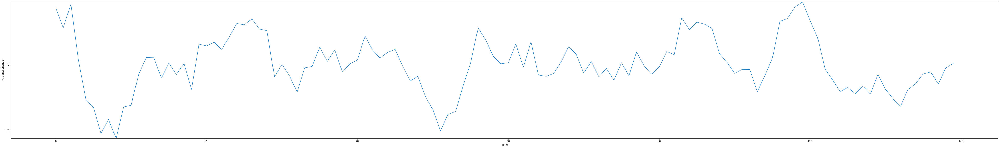

In [69]:
M_timeseries_clean=np.mean(cleaned,axis=1)
plotts(M_timeseries_clean)

## ROADMAP

1. I feel like I have everything I need to repeat the same analysis I already have, but in surface space.
2. Moreover, I don't see any real need to use anything other than python to achieve this.

All I have to do is: 

1. Denoise the signals
2. Average over runs.
3. Fit the models (on the cluster if possible).
4. Try and integrate pycortex for presentation.